<a href="https://colab.research.google.com/github/ShaneenAira/FineAppleAI/blob/main/FineApple.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import needed dependencies and datasets

here is where:
*   delete folder
*   unzip a file


In [ ]:
XD!pip install tensorflow keras opencv-python scikit-fuzzy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 920.8/920.8 kB 10.4 MB/s eta 0:00:00


In [ ]:
!pip install tensorflow keras opencv-python scikit-fuzzy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 920.8/920.8 kB 9.3 MB/s eta 0:00:00


unzip the zip file

In [2]:
import zipfile
import os

zip_path = '/content/PINEAPPLE DATA SETS.zip'  # Corrected the file path by removing the extra /
extract_folder = '/content/Dataset/'  # Destination folder

# Extract the ZIP file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_folder)

print("Dataset extracted successfully!")

Dataset extracted successfully!


Display the extracted folder from the zip file


In [9]:
import os

# List extracted files
dataset_folder = "/content/Dataset/PINEAPPLE DATA SETS/"
print("Extracted files:", os.listdir(dataset_folder))


Extracted files: ['FORMOSA', 'DOLE']


delete folder

In [16]:
import shutil

folder_path = "/content/normalized_images/"  # Change this to the folder you want to delete

shutil.rmtree(folder_path)  # Delete the folder and all its files

print(f"Deleted folder: {folder_path}")

Deleted folder: /content/normalized_images/


In [ ]:
import shutil

folder_path = '/content/Dataset'  # Replace with the actual path

shutil.rmtree(folder_path, ignore_errors=True)

# Normalization of dataset

Resizing the Dataset

In [4]:
import cv2
import os

# Function to resize an image
def resize_image(image_path, target_size=(224, 224)):
    image = cv2.imread(image_path)  # Load image
    if image is None:
        print(f"Skipping {image_path}, unable to read file.")
        return None

    resized_image = cv2.resize(image, target_size)  # Resize
    return resized_image

# Function to process all images while keeping folder structure
def resize_images_in_folders(input_folder, output_folder):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)  # Create output directory if it doesn't exist

    # Loop through varieties (DOLE, FORMOSA)
    for variety in os.listdir(input_folder):
        variety_path = os.path.join(input_folder, variety)

        if os.path.isdir(variety_path):  # Check if it's a folder
            output_variety = os.path.join(output_folder, variety)
            os.makedirs(output_variety)  # Create corresponding variety folder in resized_images

            # Loop through ripeness categories (UNRIPE, RIPE, OVERRIPE)
            for ripeness_stage in os.listdir(variety_path):
                ripeness_path = os.path.join(variety_path, ripeness_stage)

                if os.path.isdir(ripeness_path):  # Check if it's a folder
                    output_ripeness = os.path.join(output_variety, ripeness_stage)
                    os.makedirs(output_ripeness)  # Create corresponding ripeness folder

                    # Loop through images in the ripeness category
                    for img_name in os.listdir(ripeness_path):
                        img_path = os.path.join(ripeness_path, img_name)
                        resized_image = resize_image(img_path)

                        if resized_image is not None:
                            output_img_path = os.path.join(output_ripeness, img_name)
                            cv2.imwrite(output_img_path, resized_image)  # Save resized image
                            print(f"Resized and saved: {output_img_path}")

# Define paths
input_folder = "/content/Dataset/PINEAPPLE DATA SETS"  # Path where raw images are stored
output_folder = "/content/resized_images/"  # Destination folder for resized images

# Run the resizing function
resize_images_in_folders(input_folder, output_folder)


Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_24.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_3.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_4.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_6.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_26.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_13.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_10.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_27.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_21.jpg
Resized and saved: /content/resized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_31.jpg
Resized and saved: /content/resized_images/

normalizing lighting using histogram equilization

In [17]:
import cv2
import os

# Function to apply CLAHE to normalize lighting
def normalize_lighting_clahe(image_path):
    image = cv2.imread(image_path)  # Load image
    if image is None:
        print(f"Skipping {image_path}, unable to read file.")
        return None

    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)  # Convert to LAB color space
    l, a, b = cv2.split(lab)  # Split channels

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))  # Apply CLAHE to L channel
    l = clahe.apply(l)

    enhanced_image = cv2.merge((l, a, b))  # Merge back LAB channels
    enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)  # Convert back to BGR

    return enhanced_image

# Function to process all images while keeping folder structure
def normalize_images_in_folders(input_folder, output_folder):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)  # Create output directory if it doesn't exist

    for variety in os.listdir(input_folder):  # Loop through varieties (DOLE, FORMOSA)
        variety_path = os.path.join(input_folder, variety)

        if os.path.isdir(variety_path):  # Check if it's a folder
            output_variety = os.path.join(output_folder, variety)
            os.makedirs(output_variety, exist_ok=True)  # Create corresponding variety folder

            for ripeness_stage in os.listdir(variety_path):  # Loop through ripeness categories
                ripeness_path = os.path.join(variety_path, ripeness_stage)

                if os.path.isdir(ripeness_path):  # Check if it's a folder
                    output_ripeness = os.path.join(output_variety, ripeness_stage)
                    os.makedirs(output_ripeness, exist_ok=True)  # Create corresponding ripeness folder

                    for img_name in os.listdir(ripeness_path):  # Loop through images in the ripeness category
                        img_path = os.path.join(ripeness_path, img_name)
                        normalized_image = normalize_lighting_clahe(img_path)  # Apply CLAHE

                        if normalized_image is not None:
                            output_img_path = os.path.join(output_ripeness, img_name)
                            cv2.imwrite(output_img_path, normalized_image)  # Save normalized image
                            print(f"CLAHE applied and saved: {output_img_path}")

# Define paths
input_folder = "/content/resized_images/"  # Source folder with resized images
output_folder = "/content/normalized_images/"  # Destination folder for CLAHE-enhanced images

# Run CLAHE enhancement
normalize_images_in_folders(input_folder, output_folder)

CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_24.jpg
CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_3.jpg
CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_4.jpg
CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_6.jpg
CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_26.jpg
CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_13.jpg
CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_10.jpg
CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_27.jpg
CLAHE applied and saved: /content/normalized_images/FORMOSA/FORMOSA_UNRIPE/Formosa_unripe_Outdoor_21.jpg
CLAHE applied and saved: /content/normalized_images/FORMOS

# Checking images

Display the Images for checking

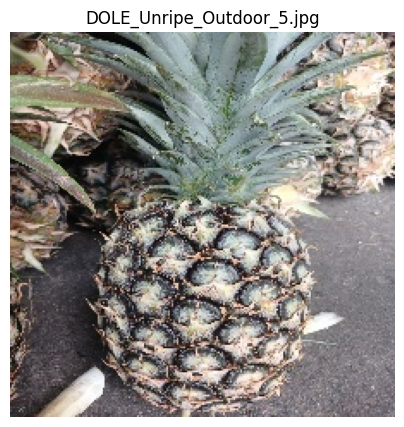

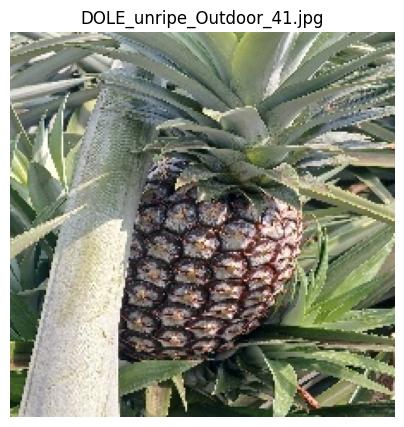

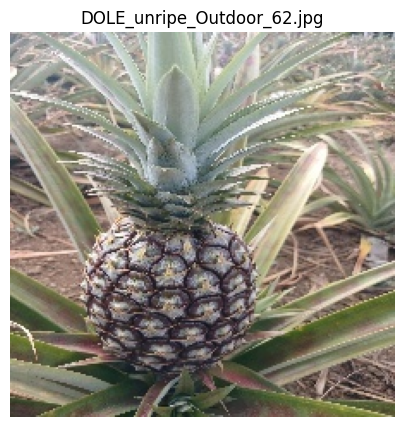

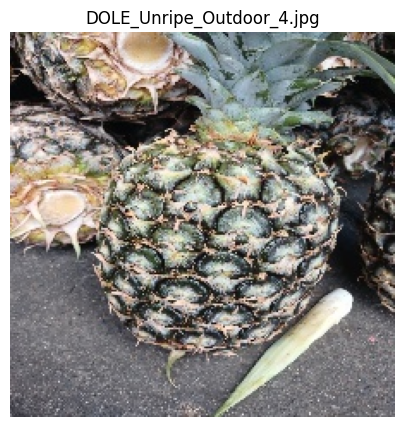

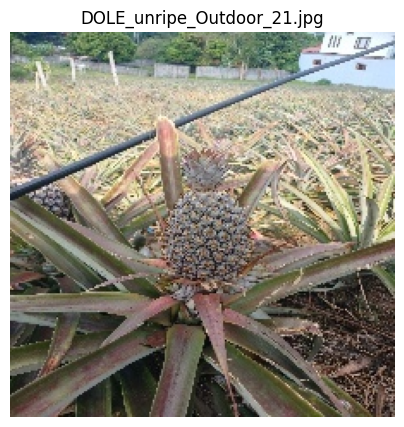

...

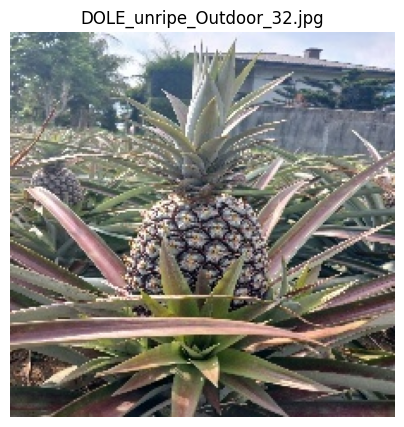

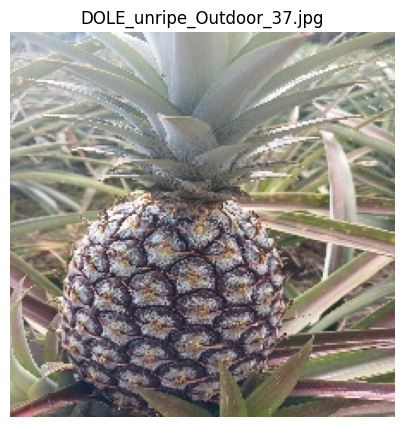

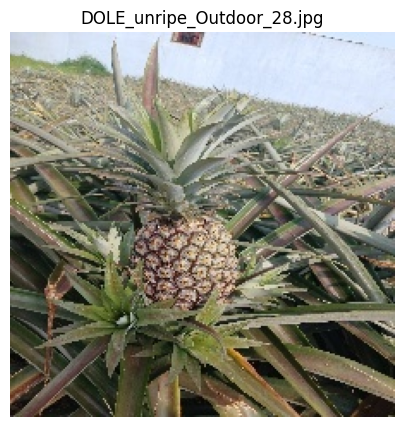

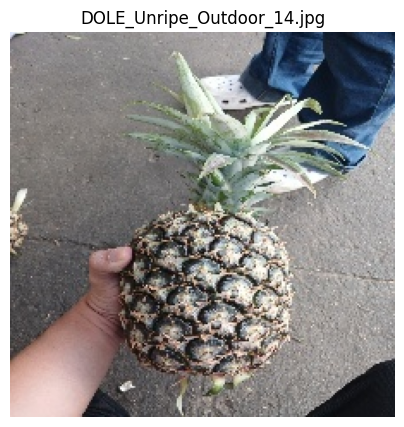

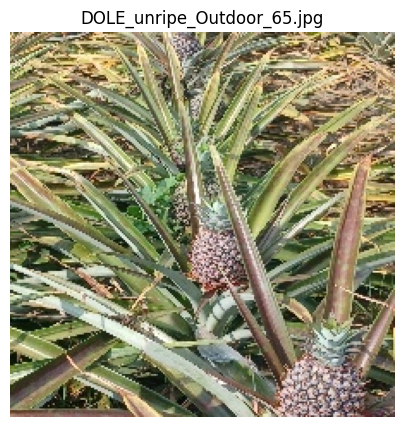

In [11]:
import matplotlib.pyplot as plt
import cv2
import os

# Define folder path
folder_path = "/content/normalized_images/DOLE/DOLE_UNRIPE/"  # Change to the folder you want

# Get list of images in the folder
image_files = [f for f in os.listdir(folder_path) if f.endswith((".jpg", ".png"))]

# Display all images
for img_name in image_files:
    img_path = os.path.join(folder_path, img_name)
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for correct color

    plt.figure(figsize=(5, 5))  # Set figure size
    plt.imshow(image)
    plt.axis("off")  # Hide axes
    plt.title(img_name)  # Show image filename
    plt.show()



compare images between normalized_images and resized_images

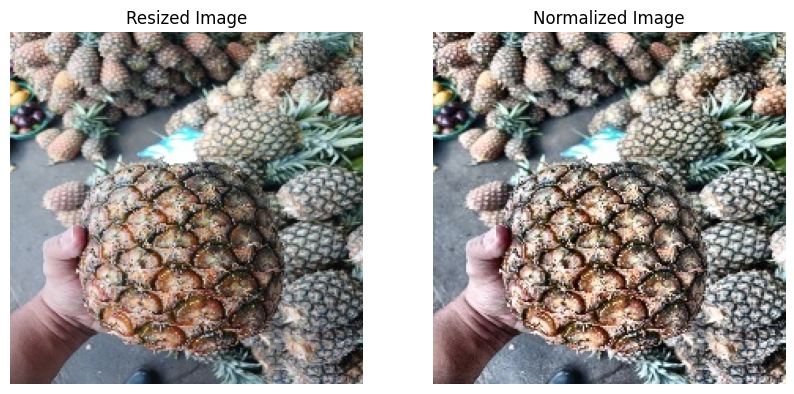

In [20]:
import cv2
import matplotlib.pyplot as plt
import os

resized_folder = "/content/resized_images/DOLE/DOLE_RIPE/"
normalized_folder = "/content/normalized_images/DOLE/DOLE_RIPE/"

# Pick an example image from resized folder
example_image = "DOLE_ripe_Outdoor_1.jpg"  # Replace with an actual filename
resized_path = os.path.join(resized_folder, example_image)
normalized_path = os.path.join(normalized_folder, example_image)

# Load images
resized_img = cv2.imread(resized_path)
normalized_img = cv2.imread(normalized_path)

# Convert from BGR to RGB for correct color representation
resized_img = cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB)
normalized_img = cv2.cvtColor(normalized_img, cv2.COLOR_BGR2RGB)

# Display side-by-side comparison
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(resized_img)
axs[0].set_title("Resized Image")
axs[0].axis("off")

axs[1].imshow(normalized_img)
axs[1].set_title("Normalized Image")
axs[1].axis("off")

plt.show()


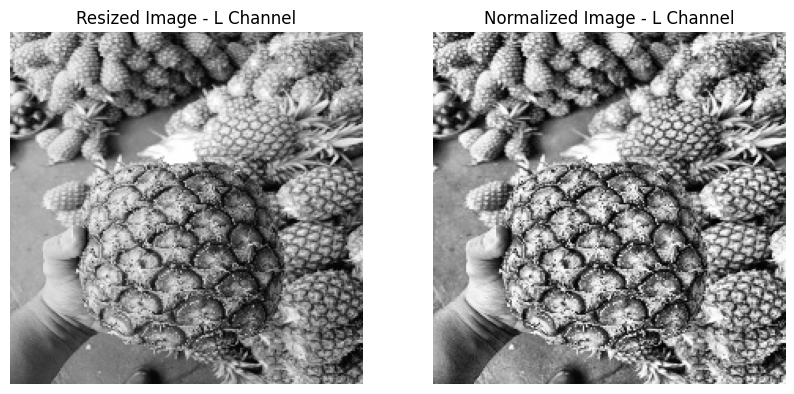

In [26]:
import cv2
import matplotlib.pyplot as plt

def show_l_channel_side_by_side(image_path_resized, image_path_normalized):
    # Load images
    image_resized = cv2.imread(image_path_resized)
    image_normalized = cv2.imread(image_path_normalized)

    # Convert images to LAB color space
    lab_resized = cv2.cvtColor(image_resized, cv2.COLOR_BGR2LAB)
    lab_normalized = cv2.cvtColor(image_normalized, cv2.COLOR_BGR2LAB)

    # Extract L channel (brightness)
    l_resized, _, _ = cv2.split(lab_resized)
    l_normalized, _, _ = cv2.split(lab_normalized)

    # Plot side by side
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    axs[0].imshow(l_resized, cmap="gray")
    axs[0].set_title("Resized Image - L Channel")
    axs[0].axis("off")

    axs[1].imshow(l_normalized, cmap="gray")
    axs[1].set_title("Normalized Image - L Channel")
    axs[1].axis("off")

    plt.show()

# Example usage
show_l_channel_side_by_side(
    "/content/resized_images/DOLE/DOLE_RIPE/DOLE_ripe_Outdoor_1.jpg",
    "/content/normalized_images/DOLE/DOLE_RIPE/DOLE_ripe_Outdoor_1.jpg"
)